In [1]:
import sys
import torch
import torchvision.transforms.functional as F
from torchvision import transforms, utils
from PIL import Image
import numpy as np
import cv2
from armory.scenarios.main import get as get_scenario
sys.path.append('..')

import warnings
warnings.filterwarnings("ignore")

s = get_scenario("/armory/tmp/2023-07-17T175428.320457/interactive-config.json").load()   

2023-07-17 17:56:31  0s INFO     armory.delayed_imports:<module>:7 Importing and configuring torch, tensorflow, and art, if available. This may take some time.


2023-07-17 17:56:34  2s INFO     armory.delayed_imports:<module>:30 Setting tf.config.experimental.set_memory_growth to True on all GPUs
2023-07-17 17:56:34  2s INFO     art.config:set_data_path:55 set ART_DATA_PATH to /tmp/.art/data
2023-07-17 17:56:34  3s INFO     art.config:set_data_path:55 set ART_DATA_PATH to /armory/saved_models/art
2023-07-17 17:56:35  3s INFO     armory.scenarios.main:_scenario_setup:49 armory outputs and logs will be written to /armory/outputs/2023-07-17T175428.320457
2023-07-17 17:56:35  4s INFO     matplotlib.font_manager:_load_fontmanager:1624 generated new fontManager
2023-07-17 17:56:36  4s INFO     armory.data.utils:maybe_download_weights_from_s3:47 Using available packaged_weights_robust.pt in Armory `saved_model_dir`
Non-A100 GPU detected, using math or mem efficient attention if input tensor is on cuda
2023-07-17 17:56:43 11s INFO     armory.scenarios.scenario:load_dataset:217 Loading test dataset carla_over_obj_det_dev...


In [2]:
diffusion = s.model.model.diffusion

def reconstruct_image(img, height, width, size):
    reshaped_tensor = img.view(width//size, height//size, 3, size, size)

    # Concatenate along the width dimension
    concatenated_tensor = torch.cat(tuple(reshaped_tensor[i] for i in range(width//size)), dim=3)

    # Concatenate along the height dimension
    concatenated_tensor = torch.cat(tuple(concatenated_tensor[i] for i in range(height//size)), dim=1)

    return concatenated_tensor.view(3, height, width)

def display_image(img):
    grid = utils.make_grid(img)
    ndarr = grid.mul(255).add_(0.5).clamp_(0, 255).permute(1, 2, 0).to("cpu", torch.uint8).numpy() 
    return Image.fromarray(ndarr)

def visualize(x: np.ndarray, y: dict, y_pred: dict, DEBUG=True):
    SIZE = 256
    THRESHOLD = 0.5
    
    x = F.to_tensor(x).cuda()
    
    x_rgb, x_depth = x[0:3], x[3:6]
    x_height, x_width = x_rgb.shape[1], x_rgb.shape[2]
    
    if DEBUG:
        original_img_pil = display_image(x_rgb)
        display(original_img_pil)
    
    # pad image to be divisible by SIZE
    x_width_pad = SIZE - x_width % SIZE if x_width % SIZE != 0 else 0
    x_height_pad = SIZE - x_height % SIZE if x_height % SIZE != 0 else 0
    
    x_pad = torch.nn.functional.pad(x_rgb, (0, x_width_pad, 0, x_height_pad), mode='constant', value=0)
    padded_height, padded_width = x_pad.shape[1], x_pad.shape[2]

    x_spliced = []
    for i in range(0, padded_width, SIZE):
        for j in range(0, padded_height, SIZE):
            x_spliced.append(x_pad[0:3, j:j+SIZE, i:i+SIZE])

    x_spliced = torch.stack(x_spliced)

    # TODO: may not need this?
    # img_spliced = img_spliced.unsqueeze(0).float().div(255).to(DEVICE)
    x_spliced = x_spliced.unsqueeze(0).float() #.to(DEVICE)
    
    x_spliced = x_spliced[0]


    # image_noisy_spliced = ((img_spliced[0]*2) - 1) + torch.randn_like(img_spliced[0]) * 0.31622776601
    x_noisy_spliced = ((x_spliced*2) - 1) + torch.randn_like(x_spliced) * np.sqrt(0.01) # 0.31622776601
    
    if True:
        noisy_pil = display_image(reconstruct_image((torch.clamp(x_noisy_spliced, -1, 1) + 1) / 2, padded_height, padded_width, SIZE))
        display(noisy_pil)

    num_slices = padded_height * padded_width // (SIZE * SIZE)
    diffusion.sampling_timesteps=20
    x_reconstructed = diffusion.ddim_sample_img(x_noisy_spliced, (num_slices, 3, SIZE, SIZE), return_all_timesteps=True, tqdm_disabled=True)
    
    x_reconstructed_neg1 = x_reconstructed[:, x_reconstructed.shape[1]-2,:,:,:]

    x_final = reconstruct_image(x_reconstructed_neg1, padded_height, padded_width, SIZE)[:, 0:x_height, 0:x_width]

    # normalize x_final
    x_final = x_final - x_final.min()
    x_final = x_final / x_final.max()
    
    image_diff = abs(x_final - x_rgb).sum(dim=0)
    
    if DEBUG:
        image_diff_np = (255*image_diff).cpu().numpy().astype(np.uint8)
        heatmap = cv2.applyColorMap(image_diff_np, cv2.COLORMAP_JET)
        image_diff_pil = Image.fromarray(heatmap)
        display(image_diff_pil)
        
    if DEBUG:
        final_img_pil = display_image(x_final)
        display(final_img_pil)

    # dynamic threshold for mask
    mask = image_diff > image_diff.max() * THRESHOLD

    # TODO: adjust size of kernel
    kernel = np.ones((7, 7), dtype='uint8')
    mask = cv2.dilate(mask.cpu().numpy().astype(np.uint8), kernel)

    # duplicate mask for each channel
    mask = torch.stack([torch.from_numpy(mask) for _ in range(6)], dim=0)
    
    x_fixed = x.detach().clone()
    x_fixed[mask] = 0
    
    
#    # forward patch checker
#     x = F.to_tensor(x).cuda()
#     x_rgb, x_depth = x[0:3], x[3:6]
#     mask, loss = patch_checker(x_rgb, x_depth)
    
#     # repair rgb
#     x_fixed = x.detach().clone()
#     x_fixed[0:3] = x_rgb.data * mask + x_depth.data * (1 - mask)
#     x_fixed = x_fixed.cpu().permute((1,2,0))
    
    # vis
    s.sample_exporter.get_sample(x_fixed[0:3].cpu().permute((1,2,0)), with_boxes=True, y=y, y_pred=y_pred).show()


def evaluate_and_show_next(max_iter: int = 1000):
    # Set ad-hoc attack steps
    s.attack.max_iter = max_iter
    
    # Evaluate one sample
    s.next()
    s.evaluate_current()
    
    # Display benign
    visualize(s.x[0], s.y[0], s.y_pred[0])
    
    # Show adversarial
    visualize(s.x_adv[0], s.y[0], s.y_pred_adv[0])

Evaluating sample 0...


Adversarial Patch PyTorch:   0%|          | 0/10 [00:00<?, ?it/s]

2023-07-17 17:57:08 36s WARNING  armory.scenarios.carla_object_detection:run_attack:71 Adversarial attack perturbed depth channels


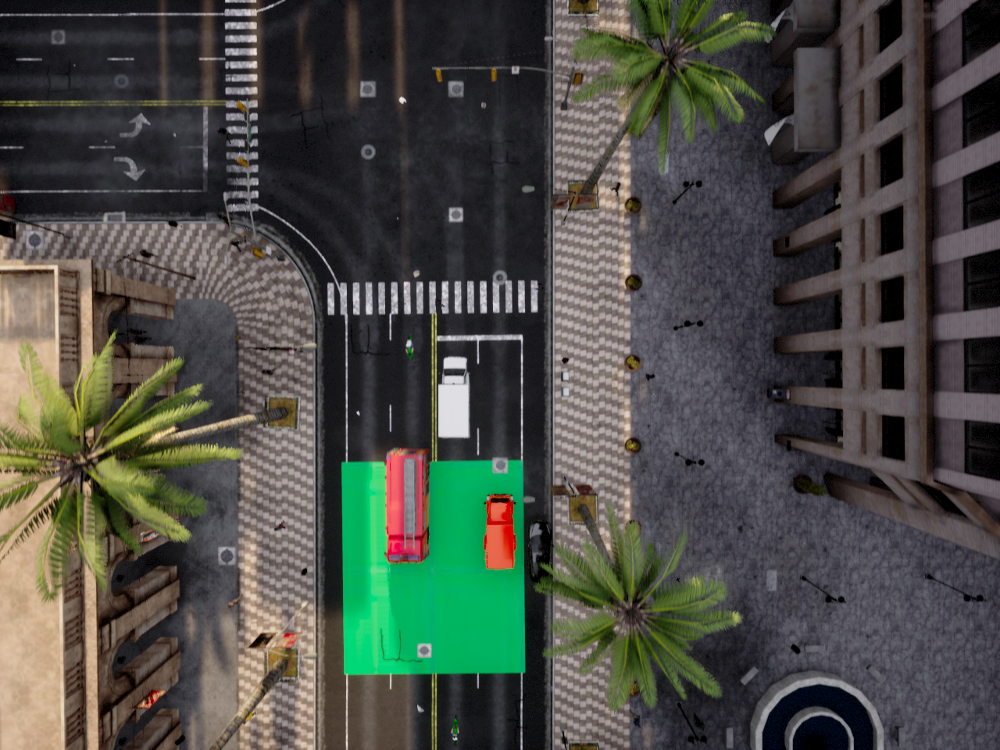

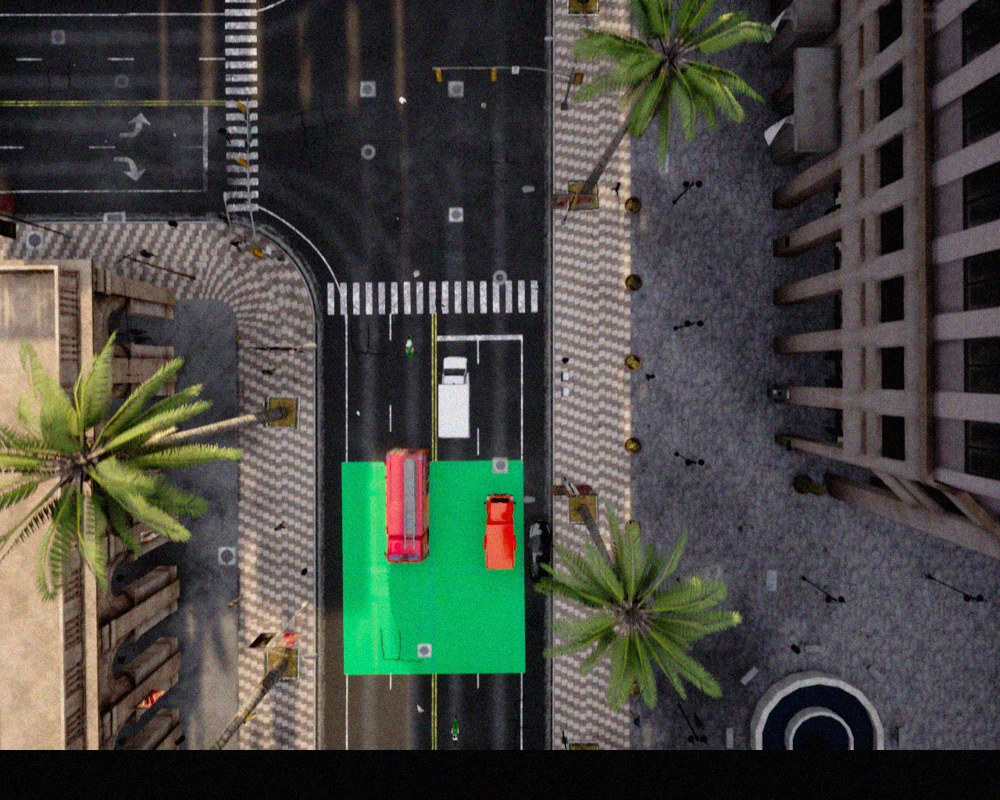

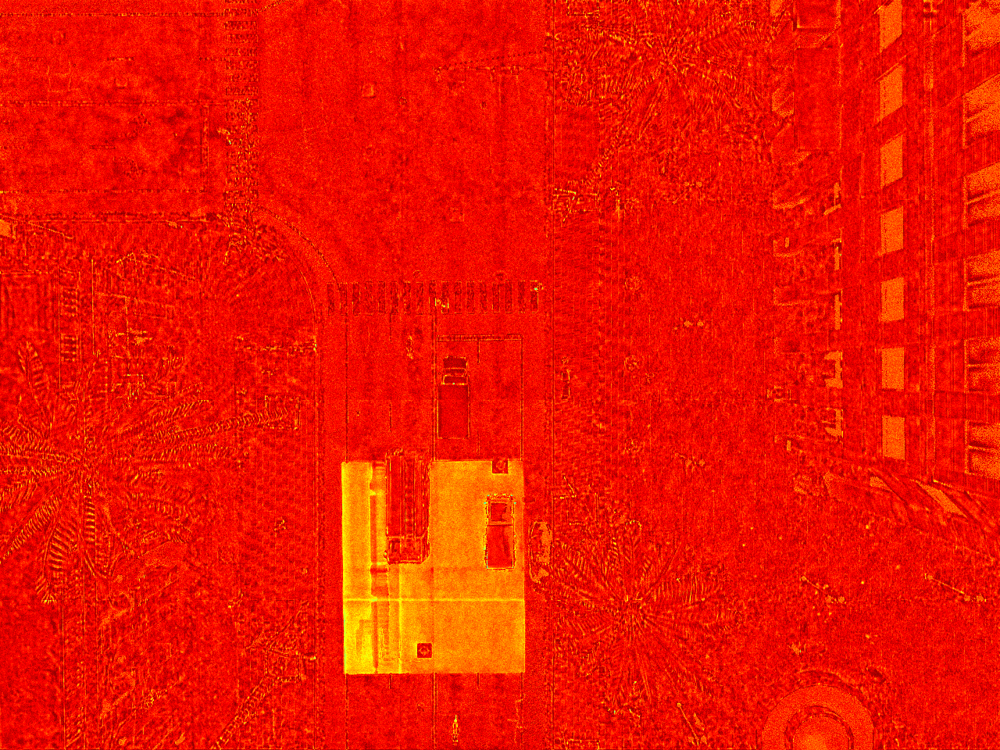

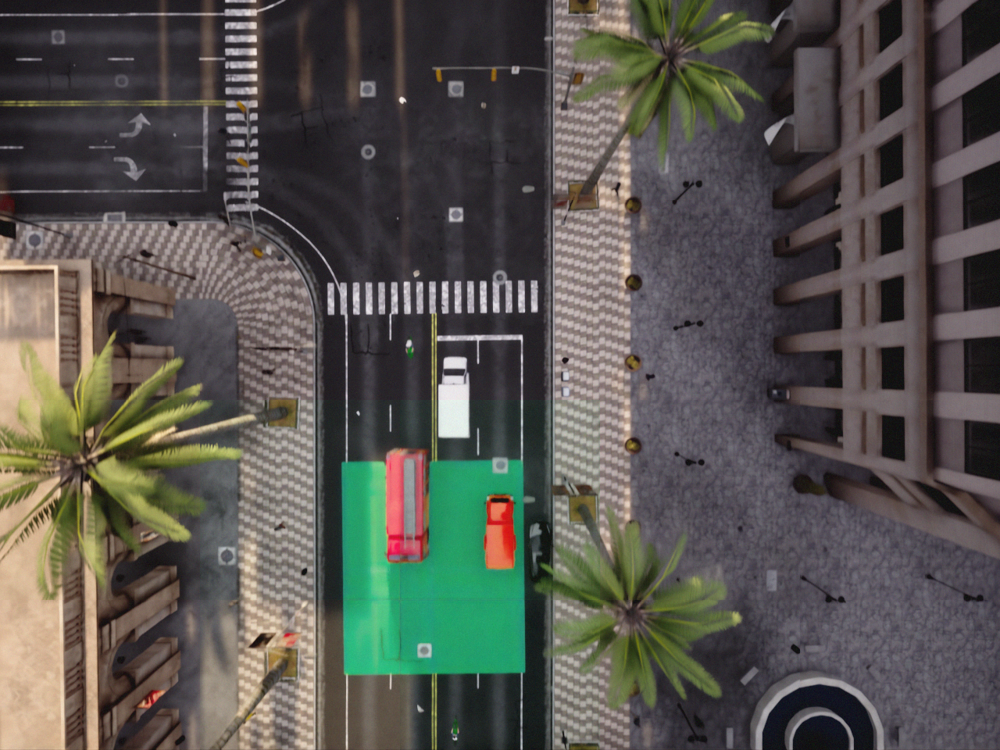

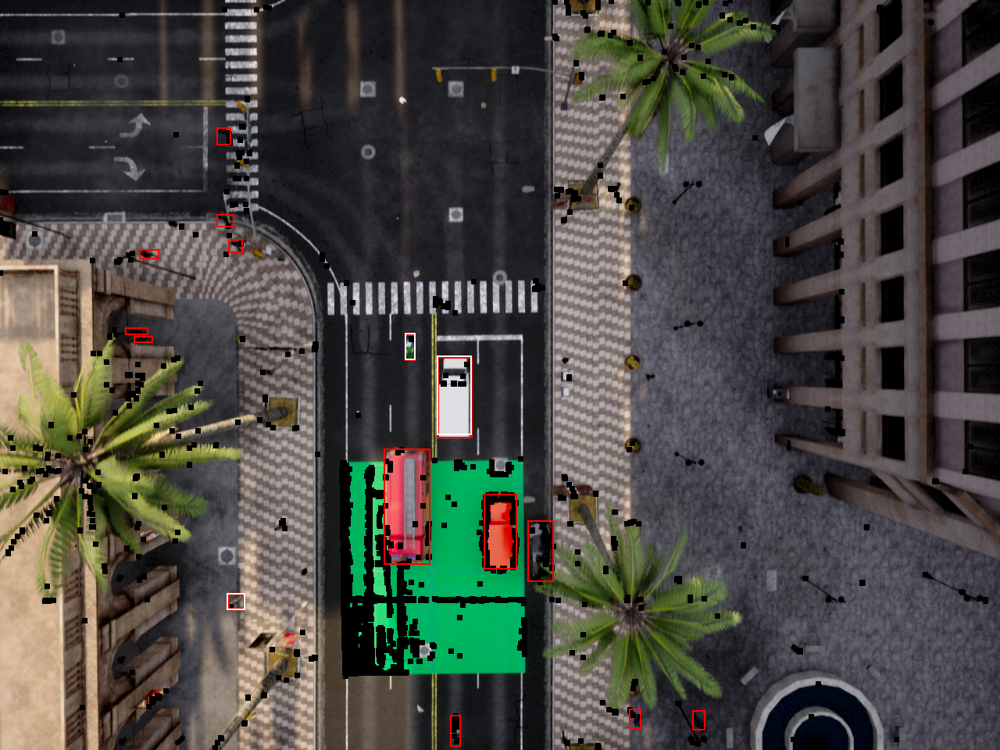

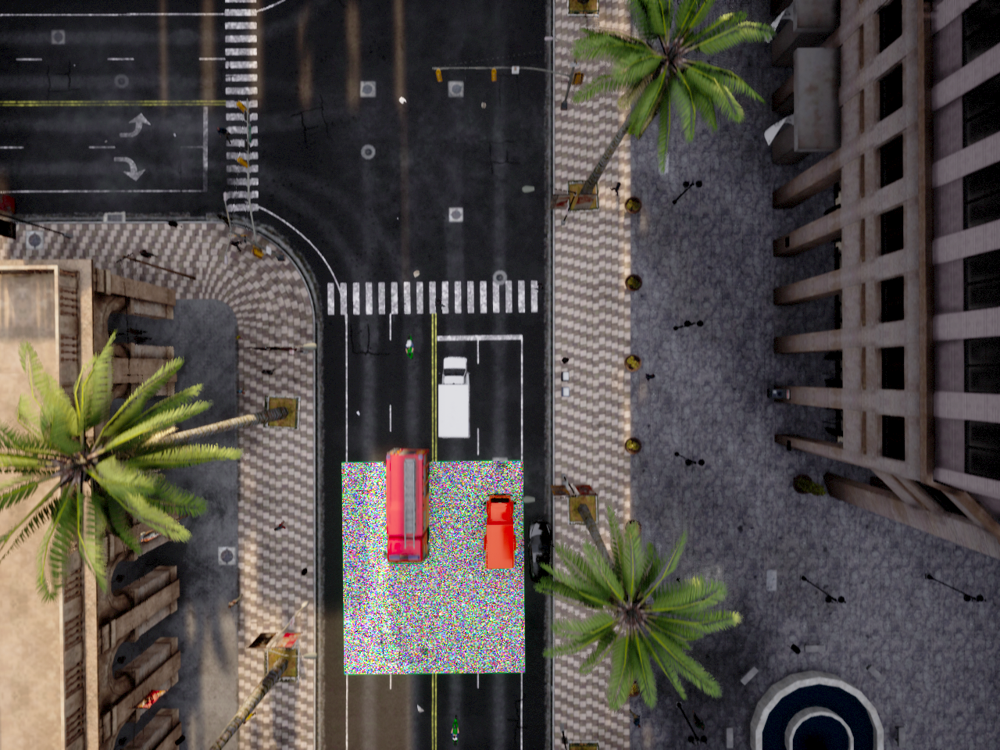

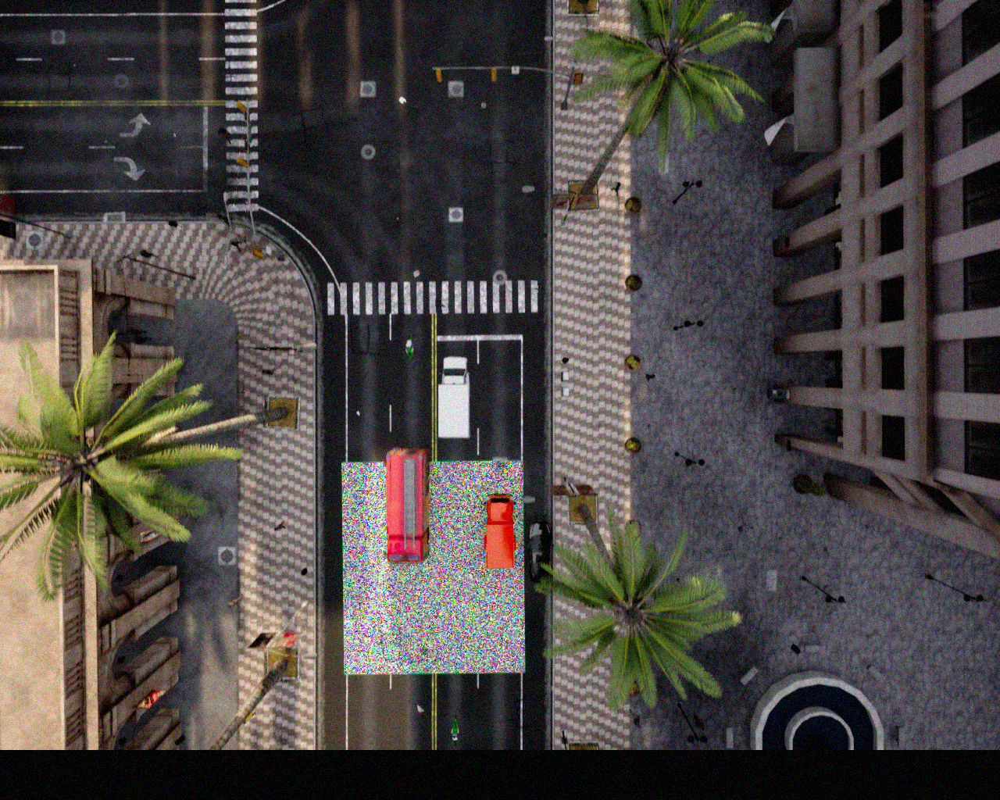

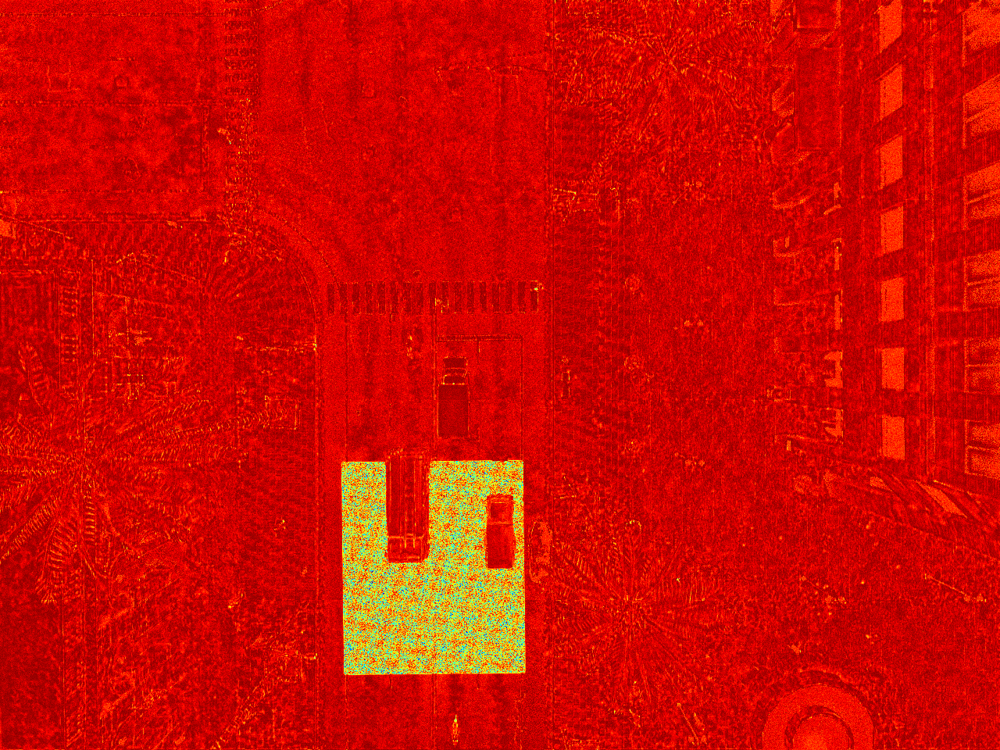

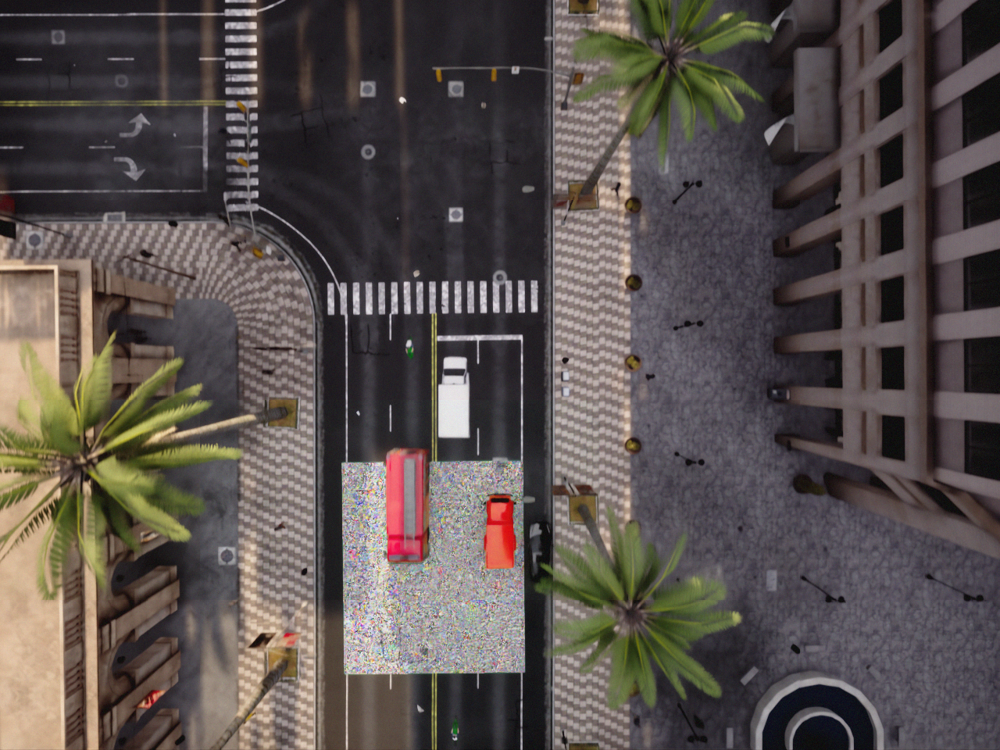

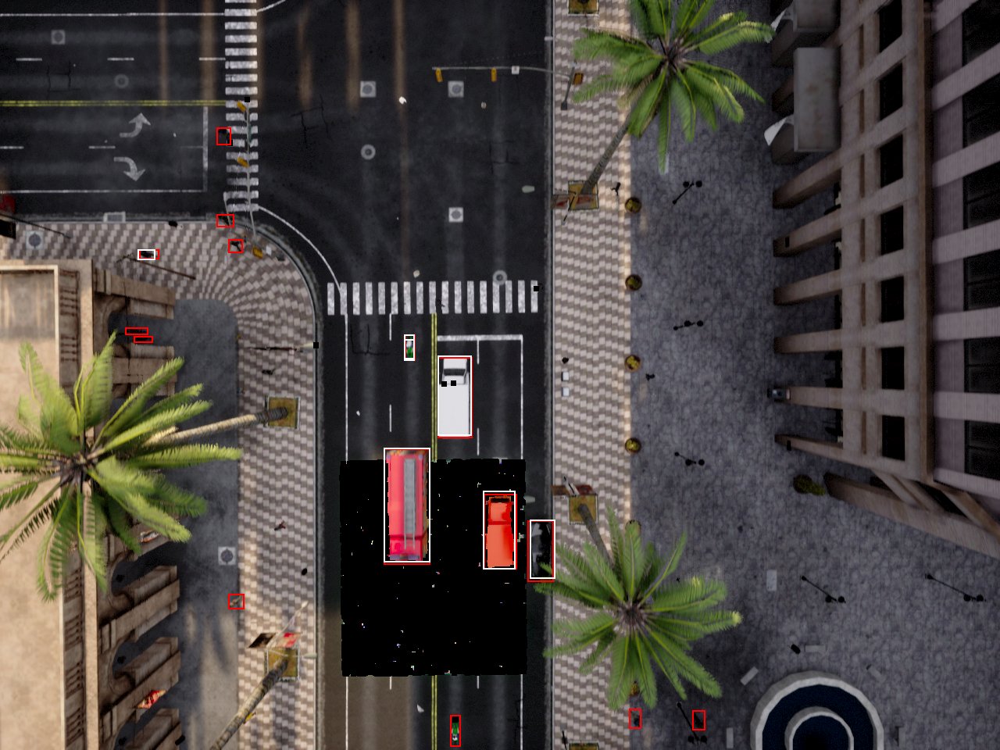

In [3]:
QUICK_TEST_ITERS = 10

for i in range(1):
    print(f'Evaluating sample {i}...')
    evaluate_and_show_next(max_iter=QUICK_TEST_ITERS)